In [13]:
%matplotlib inline

import json

import numpy as np
from scipy.signal import find_peaks

from rascal.calibrator import Calibrator
from rascal.util import refine_peaks


In this example, we'll calibrate a spectrum from the DEep Imaging Multi-Object Spectrograph (DEIMOS) instrument on Keck. We load an example calibration spectrum from the `pypeit` library. (This requires the 1D arc spectrum from github, as of 6 April 2020, https://github.com/pypeit/PypeIt.git):

In [14]:
# Load the 1D Spectrum from Pypeit
spectrum_json = json.load(
    open('data_keck_deimos/keck_deimos_830g_l_PYPIT.json'))
spectrum = np.array(spectrum_json['spec'])


This spectrum is from the 830G grating and contains Ne, Ar, Kr arc lines.

In [15]:
# Identify the arc lines
peaks, _ = find_peaks(spectrum, prominence=200, distance=10)
peaks = refine_peaks(spectrum, peaks, window_width=3)

As this is a reference template, it also has the wavelengths per pixel which we can use to check our calibration solution.

We'll use this as a hint for the spectral range of the instrument (setting the min/max range). To present a more fair scenario, we pick an approximate min/max and set a tolerance of 500A.

As usual we tell rascal the number of pixels on the detector, a fit tolerance appropriate to the instrument (in this case, we set a slightly lower fit tolerance.

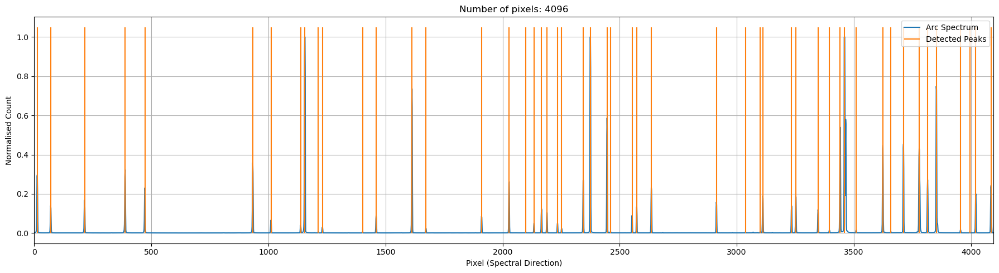

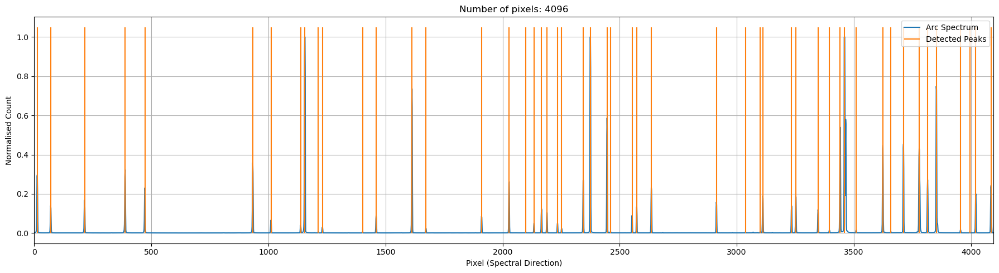

In [16]:
c = Calibrator(peaks, spectrum=spectrum)
c.plot_arc()

In [17]:
c.use_plotly()
c.plot_arc(renderer='notebook')
c.use_matplotlib()

In [18]:
c.set_hough_properties(num_slopes=2000.,
                       range_tolerance=150.,
                       linearity_tolerance=50,
                       xbins=200,
                       ybins=200,
                       min_wavelength=6000.,
                       max_wavelength=10000.)
c.set_ransac_properties(sample_size=5,
                        top_n_candidate=5,
                        minimum_matches=14,
                        linear=True,
                        filter_close=True,
                        ransac_tolerance=5,
                        candidate_weighted=True,
                        hough_weight=1.0)
c.add_atlas(elements=["Ne", "Ar", "Kr"],
            min_intensity=500.,
            pressure=70000.,
            temperature=285.)
c.do_hough_transform()


[Wed, 11 Jan 2023 15:43:53] WARNING [calibrator.py:1428] Using add_atlas is now deprecated. Please use the new Atlas class.


  0%|          | 0/2000 [00:00<?, ?it/s]

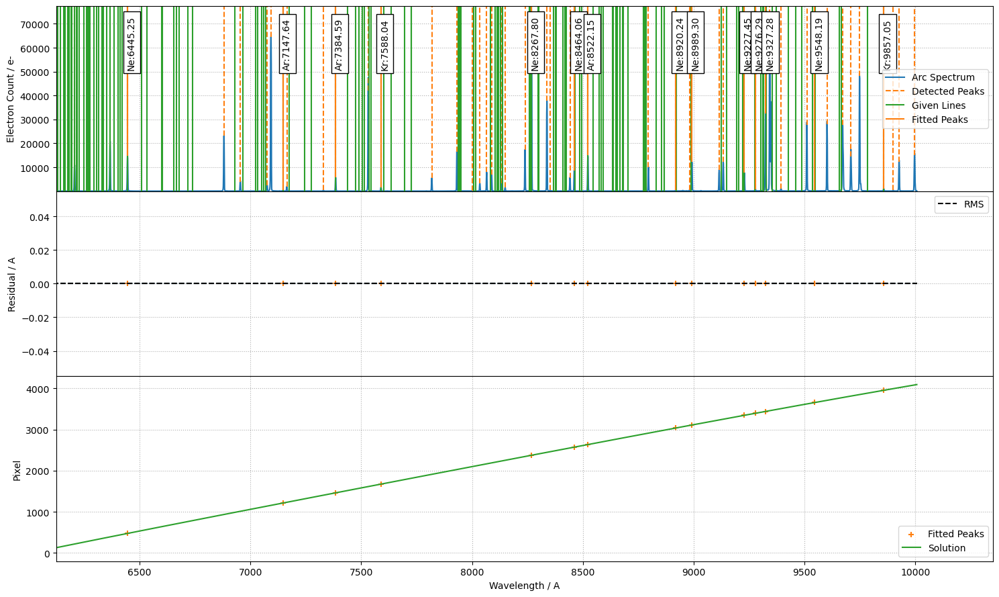

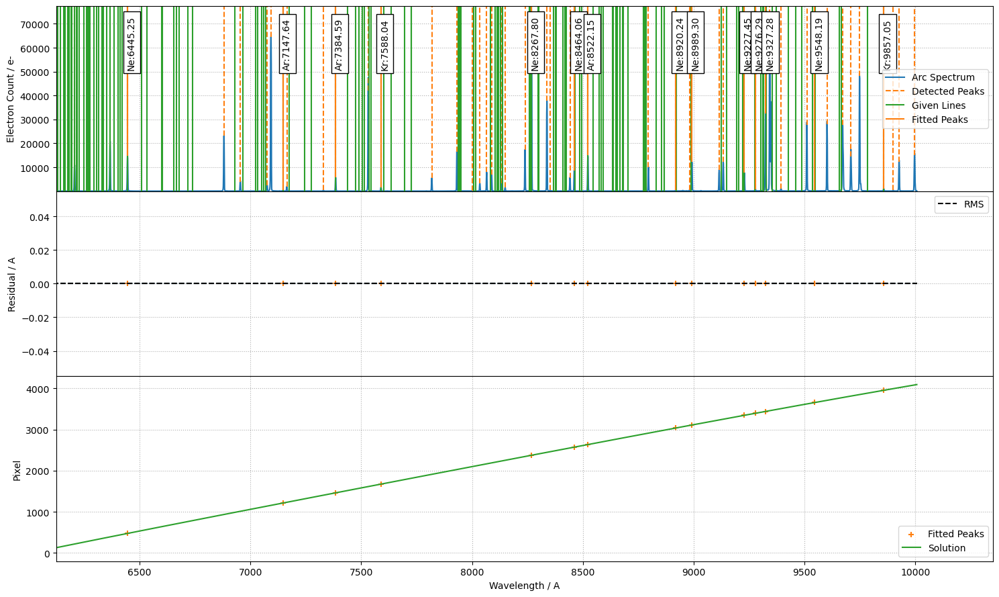

In [19]:
# Run the wavelength calibration
(best_p, matched_peaks, matched_atlas, rms, residual, peak_utilisation,
 atlas_utilisation) = c.fit(max_tries=2000)

# Plot the solution
c.plot_fit(best_p, spectrum, plot_atlas=True, log_spectrum=False, tolerance=5.)

In [20]:
c.use_plotly()
c.plot_fit(best_p, spectrum, plot_atlas=True, log_spectrum=False, tolerance=5., renderer='notebook')
c.use_matplotlib()

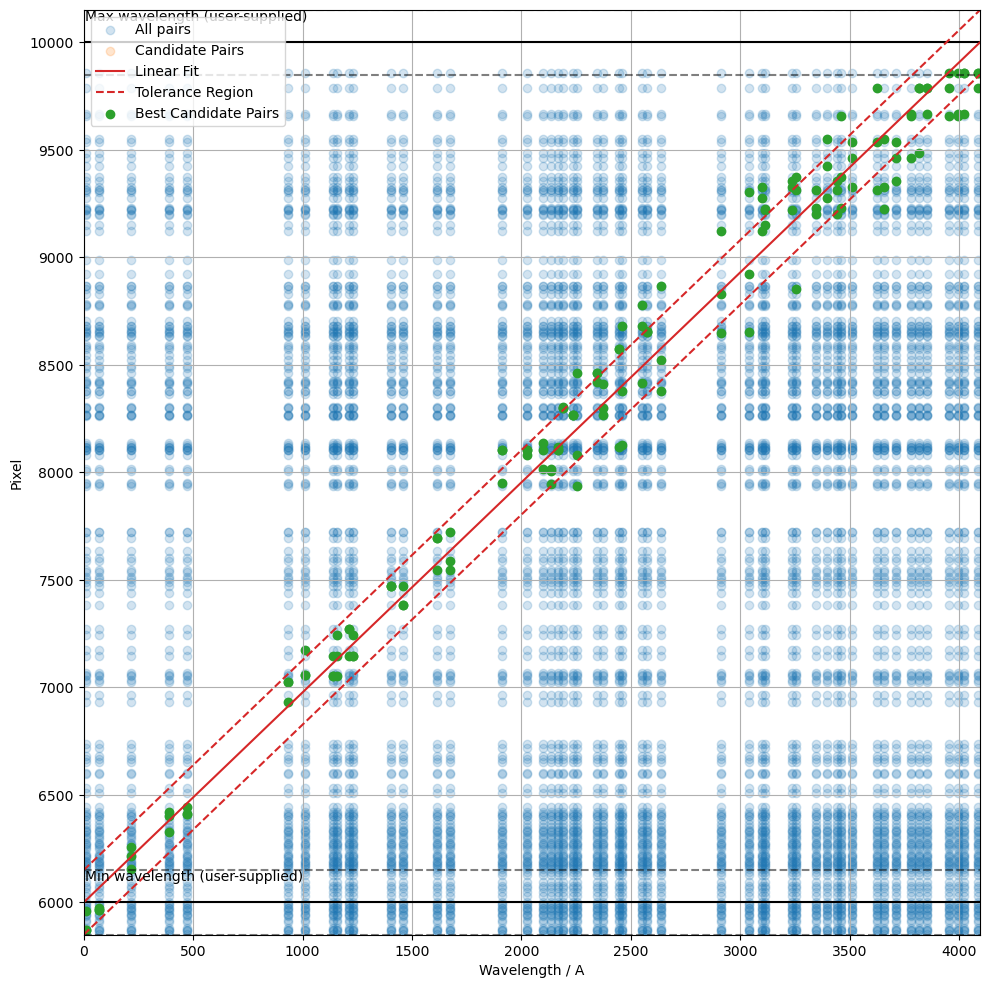

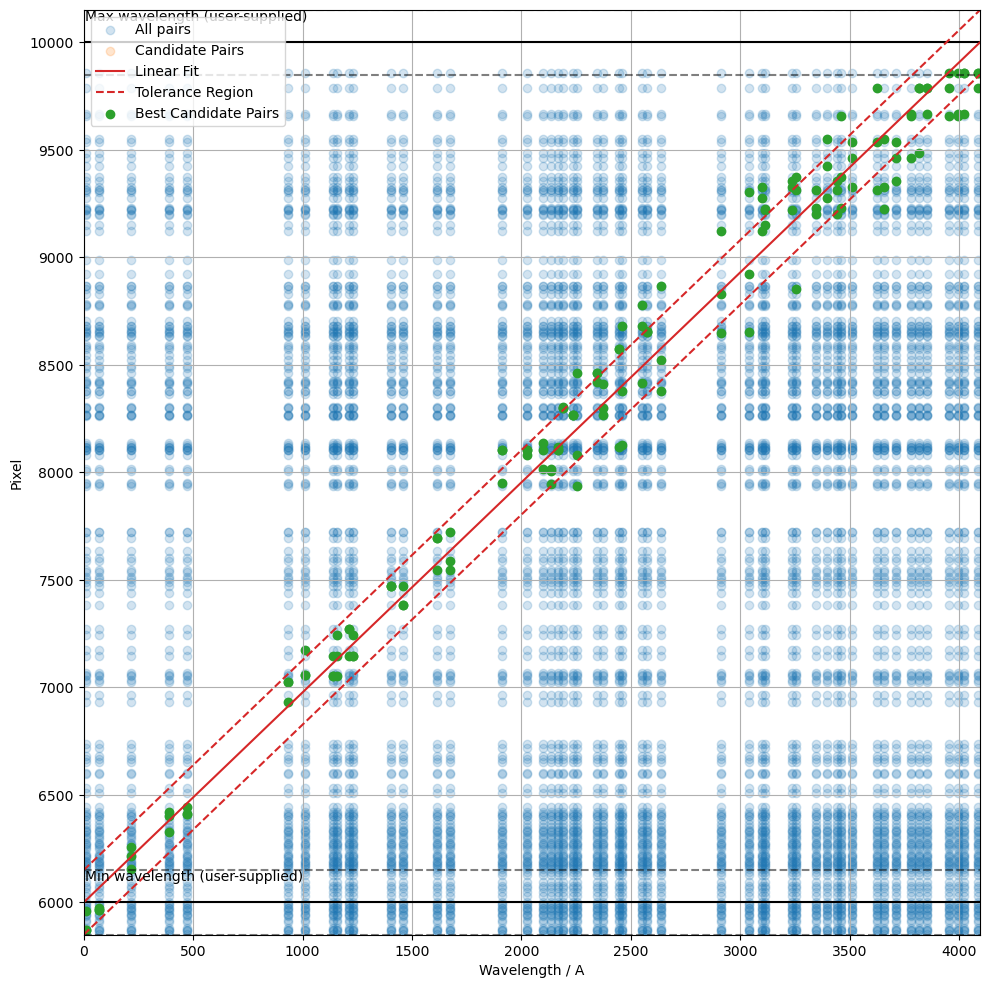

In [21]:
c.plot_search_space()

In [22]:
c.use_plotly()
c.plot_search_space(renderer='notebook')

In [23]:
print("Stdev error: {} A".format(residual.std()))
print("Peaks utilisation rate: {}%".format(peak_utilisation * 100))
print("Atlas utilisation rate: {}%".format(atlas_utilisation * 100))

Stdev error: 1.5971563827712598 A
Peaks utilisation rate: 27.450980392156865%
Atlas utilisation rate: 8.433734939759036%
